In [5]:
import sklearn
import pandas as pd
import numpy as np
import nltk
import sklearn
from nltk.tokenize import word_tokenize
from nltk import pos_tag
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from sklearn.preprocessing import LabelEncoder
from collections import defaultdict
from nltk.corpus import wordnet as wn
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn import model_selection, naive_bayes, svm
from sklearn.metrics import accuracy_score
import matplotlib
from sklearn.model_selection import cross_val_score
from scipy.stats import uniform as sp_randFloat
from scipy.stats import randint as sp_randInt
from sklearn.model_selection import train_test_split
import re
from nltk.stem import PorterStemmer
from nltk.stem.snowball import SnowballStemmer
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.naive_bayes import MultinomialNB
from sklearn.pipeline import Pipeline
from sklearn import metrics
from sklearn.model_selection import RandomizedSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import SGDClassifier
import pickle
from wordcloud import WordCloud

In [6]:
stemmer = SnowballStemmer("dutch")
np.random.seed(500)

def create_preprocess_corpus(input_csv, content_name, label_name, smoking=False, second_experiment=False, skip_rows=[]):
    corpus = pd.read_csv(input_csv,encoding='latin-1', skiprows=skip_rows)
    corpus = corpus.rename({content_name:'text', label_name: 'label'}, axis=1)
    corpus['text'] = corpus['text'].str.replace('\t',' ')
    corpus.drop(['Unnamed: 0'], axis=1, inplace=True)
    corpus.drop_duplicates(inplace=True)
    corpus['text'] = corpus['text'].astype(str)
    corpus['text'] = corpus['text'].str.lower()
    #corpus['text'].replace(to_replace="[^\w\s]", value="", regex=True, inplace=True)
    corpus['text'] = [stemmer.stem(text) for text in corpus['text']]
    if second_experiment:
        if smoking:
            replace_text = 'Rookt niet'
            corpus['label'] = corpus['label'].str.replace('Niets gevonden', 'Rookt niet')
            corpus['label'] = corpus['label'].str.replace('Rookte', 'Rookt niet')
        else:
            corpus['label'] = corpus['label'].str.replace('Niets gevonden', 'Nee')
        
    corpus = corpus.drop(corpus[corpus.label == '--'].index)
    corpus = corpus.drop(corpus[corpus.label == 'Onbekend'].index)
    corpus_backup = corpus.copy()
    return corpus, corpus_backup

def create_original_corpus(input_csv, content_name, label_name, skip_rows=[]):
    corpus = pd.read_csv(input_csv,encoding='latin-1', skiprows=skip_rows)
    corpus = corpus.rename({content_name:'text', label_name: 'label'}, axis=1)
    corpus_backup = corpus.copy()
    return corpus, corpus_backup

# Smoking experiment 1

In [7]:
full_smoking_corpus, full_smoking_corpus_backup = create_preprocess_corpus("../../input_data/smoking/labelled_smoking.csv", "roken_report_content", "roken_answer_label")

In [16]:
full_text_wordcloud = WordCloud().generate(' '.join(full_smoking_corpus['text']))

(-0.5, 399.5, 199.5, -0.5)

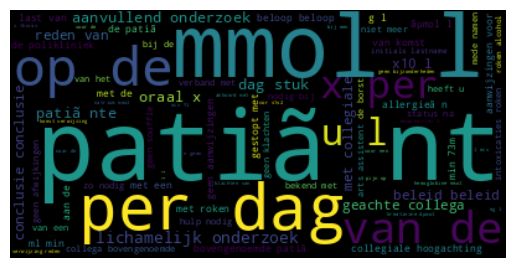

In [17]:
import matplotlib.pyplot as plt
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")


In [8]:
_, smoking_x_test, _, smoking_y_test = train_test_split(full_smoking_corpus['text'], full_smoking_corpus['label'], test_size=0.2, random_state=50)

(-0.5, 399.5, 199.5, -0.5)

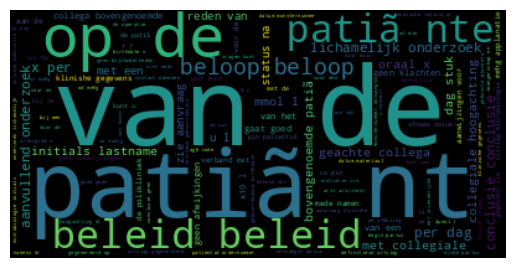

In [18]:
nothing_found_wordcloud = WordCloud().generate(' '.join(full_smoking_corpus[full_smoking_corpus['label'] == 'Niets gevonden']['text']))
plt.imshow(nothing_found_wordcloud, interpolation='bilinear')
plt.axis("off")

(-0.5, 399.5, 199.5, -0.5)

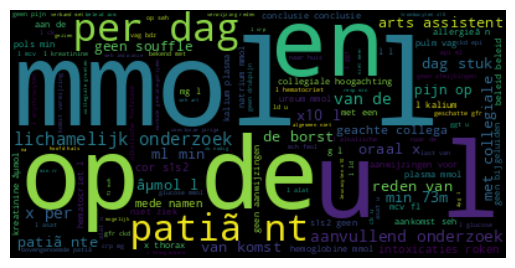

In [20]:
#user_wordcloud = WordCloud().generate(' '.join(full_smoking_corpus[full_smoking_corpus['label'] == 'Rookt']['text']))
plt.imshow(user_wordcloud, interpolation='bilinear')
plt.axis("off")

(-0.5, 399.5, 199.5, -0.5)

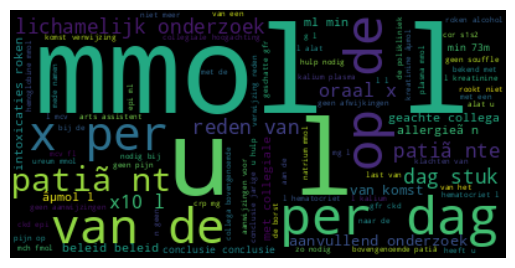

In [21]:
non_user_wordcloud = WordCloud().generate(' '.join(full_smoking_corpus[full_smoking_corpus['label'] == 'Rookt niet']['text']))
plt.imshow(non_user_wordcloud, interpolation='bilinear')
plt.axis("off")

(-0.5, 399.5, 199.5, -0.5)

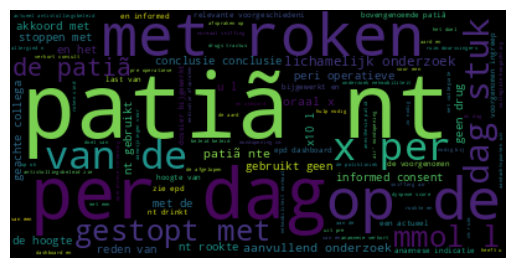

In [22]:
previous_user_wordcloud = WordCloud().generate(' '.join(full_smoking_corpus[full_smoking_corpus['label'] == 'Rookte']['text']))
plt.imshow(previous_user_wordcloud, interpolation='bilinear')
plt.axis("off")

In [9]:
original_smoking_corpus, _ = create_original_corpus("../../input_data/smoking/labelled_smoking.csv", "roken_report_content", "roken_answer_label")

In [11]:
model = pickle.load(open('../best_models/best_smoking_ex1.pkl', 'rb'))

In [31]:
model.best_estimator_._final_estimator.coef_.shape

(4, 959763)

In [35]:
ex1_features = model.best_estimator_['tfidf'].get_feature_names_out()
ex1_coef = model.best_estimator_['clf'].coef_
feature_importance = pd.DataFrame(ex1_features, columns=['feature'])
feature_importance['nothing_found_importance'] = ex1_coef[0]
feature_importance['current_user_importance'] = ex1_coef[1]
feature_importance['non_user_importance'] = ex1_coef[2]
feature_importance['previous_user_importance'] = ex1_coef[3]

In [38]:
nothing_found_dictionary = {row['feature']:row['nothing_found_importance'] for index, row in feature_importance.iterrows()}


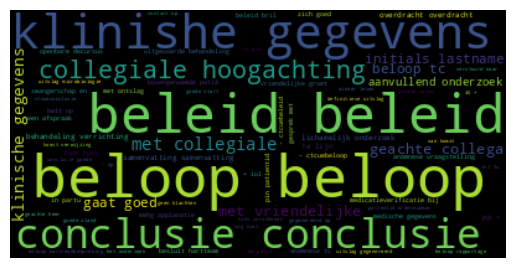

In [40]:
wc = WordCloud().generate_from_frequencies(nothing_found_dictionary)
plt.imshow(wc, interpolation="bilinear")
plt.axis("off")
plt.show()

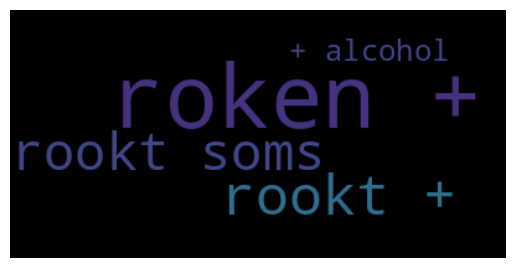

In [41]:
current_user_dictionary = {row['feature']:row['current_user_importance'] for index, row in feature_importance.iterrows()}
wc = WordCloud().generate_from_frequencies(current_user_dictionary)
plt.imshow(wc, interpolation="bilinear")
plt.axis("off")
plt.show()

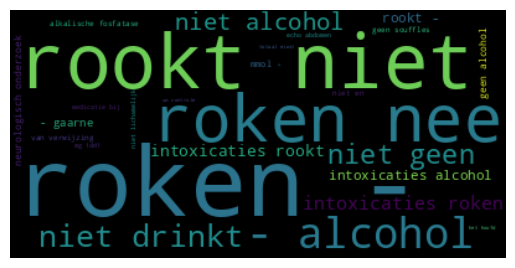

In [42]:
non_user_dictionary = {row['feature']:row['non_user_importance'] for index, row in feature_importance.iterrows()}
wc = WordCloud().generate_from_frequencies(non_user_dictionary)
plt.imshow(wc, interpolation="bilinear")
plt.axis("off")
plt.show()

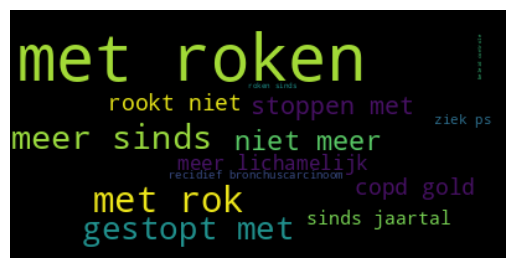

In [44]:
previous_user_dictionary = {row['feature']:row['previous_user_importance'] for index, row in feature_importance.iterrows()}
wc = WordCloud().generate_from_frequencies(previous_user_dictionary)
plt.imshow(wc, interpolation="bilinear")
plt.axis("off")
plt.show()

0.98369967063252


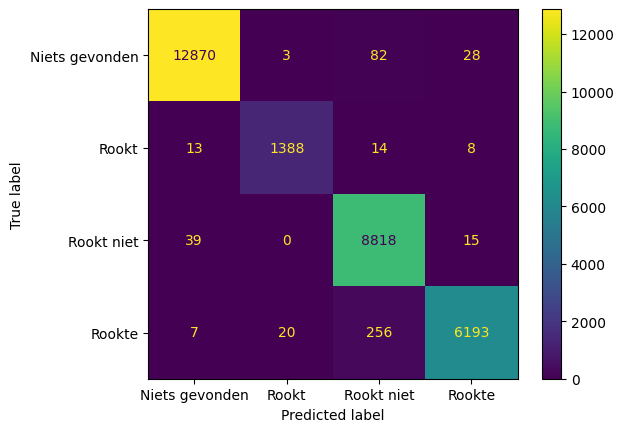

                precision    recall  f1-score   support

Niets gevonden       1.00      0.99      0.99     12983
         Rookt       0.98      0.98      0.98      1423
    Rookt niet       0.96      0.99      0.98      8872
        Rookte       0.99      0.96      0.97      6476

      accuracy                           0.98     29754
     macro avg       0.98      0.98      0.98     29754
  weighted avg       0.98      0.98      0.98     29754



In [12]:
predicted_nb = model.predict(smoking_x_test)
print(np.mean(predicted_nb == smoking_y_test))
cm = confusion_matrix(smoking_y_test, predicted_nb)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              display_labels=model.classes_)
disp.plot()

plt.show()
print(metrics.classification_report(smoking_y_test, predicted_nb,
    target_names=model.classes_))

In [8]:
predicted_nb = model.decision_function(smoking_x_test)

In [10]:
predicted_nb.shape

(29754, 4)

In [11]:
predicted_nb_labels = model.predict(smoking_x_test)


In [14]:
x_test_probs = pd.DataFrame(smoking_x_test, columns=['text'])

In [22]:
x_test_probs['nothing_found_eval'] = [x[0] for x in predicted_nb]
x_test_probs['current_user_eval'] = [x[1] for x in predicted_nb]
x_test_probs['non_user_eval'] = [x[2] for x in predicted_nb]
x_test_probs['previous_user_eval'] = [x[3] for x in predicted_nb]

In [25]:
x_test_probs['predicted_label'] = predicted_nb_labels

In [27]:
x_test_probs['true_label'] = smoking_y_test

In [34]:
x_test_probs_merged = x_test_probs.merge(original_smoking_corpus['text'], left_index=True, right_index=True, suffixes = ['_processed', '_original'])

In [35]:
x_test_probs_merged

,text_processed,nothing_found_eval,current_user_eval,non_user_eval,previous_user_eval,predicted_label,true_label,text_original
52604,"geachte collega, aankomst seh: 03-09-2017 1...",-1.493861,3.043552,-2.361478,-1.822671,Rookt,Rookt,"Geachte collega,\t\tAankomst SEH: 03-09-2017 ..."
189529,conclusie: goed herstel na sec sectio op foet...,0.000000,-0.217268,-0.277010,-0.271422,Niets gevonden,Niets gevonden,Conclusie: \tGoed herstel na sec sectio op foe...
194375,samenvatting: klinisch - nstemi 24-10-2021 ca...,0.989299,-1.668971,-1.446425,-1.491081,Niets gevonden,Niets gevonden,Samenvatting: \tKlinisch - NSTEMI\t24-10-2021 ...
3669,reden van komst / verwijzing: reden verwijzin...,-1.213153,-1.527357,1.074997,-1.322336,Rookt niet,Rookt niet,Reden van komst / Verwijzing: \tReden verwijzi...
16627,- aankomst seh: 16-01-2015 15:51 indicatie: p...,-2.244010,0.323578,-1.060256,0.383643,Rookte,Rookte,-\tAankomst SEH: 16-01-2015 15:51\tIndicatie:...
...,...,...,...,...,...,...,...,...
86632,samenvatting: samenvatting zwangerschap en be...,1.107387,-1.199042,-1.354848,-1.248919,Niets gevonden,Niets gevonden,Samenvatting: \tSamenvatting zwangerschap en b...
135809,"geachte collega, bovengenoemde patiã«nte zage...",-2.022909,3.602126,-2.554082,-2.055923,Rookt,Rookt,"Geachte collega,\t\tBovengenoemde patiÃ«nte za..."
54497,"geachte collega, bovengenoemde patiã«nt werd ...",-4.447241,0.949754,-5.728907,3.117754,Rookte,Rookte,"Geachte collega,\t\tBovengenoemde patiÃ«nt wer..."
45650,reden van komst / verwijzing: reden verwijzin...,1.236057,-1.827369,-1.591920,-1.781696,Niets gevonden,Niets gevonden,Reden van komst / Verwijzing: \tReden verwijzi...


In [41]:
pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_rows', None)

In [42]:
x_test_probs_merged[x_test_probs_merged['predicted_label'] == 'Rookt niet'].sort_values(by=['current_user_eval'], ascending=False).head(100)

,text_processed,nothing_found_eval,current_user_eval,non_user_eval,previous_user_eval,predicted_label,true_label,text_original
191645,anamnese: intoxicaties: rookt -alcohol niet. sociale anamnese: klusbedrijf familie-anamnese:,-2.046836,0.000000,5.465704,-1.488581,Rookt niet,Rookt niet,Anamnese: \tIntoxicaties: rookt -alcohol niet.\tSociale anamnese: klusbedrijf\tFamilie-anamnese:
145975,"samenvatting: 14-10-2020 vitrectomie + iris claw lens ivm lens luxatie od. post-op verhoogde oogdruk waarvoor start cosopt. anamnese: hr belt op. heeft visusklachten. moest retour eigen oogarts, zie nov. 2020, dus geadviseerd naar eigen oogarts te gaan.",-0.036727,-0.017873,0.000000,-0.018974,Rookt niet,Niets gevonden,"Samenvatting: \t14-10-2020 vitrectomie + iris claw lens ivm lens luxatie OD.\tPost-op verhoogde oogdruk waarvoor start Cosopt.\t\t\tAnamnese: \thr belt op. heeft visusklachten. moest retour eigen oogarts, zie nov. 2020, dus geadviseerd naar eigen oogarts te gaan."
101189,"beloop: mail ontvangen van g. van kinderen (jeugdbescherming)op verzoek van patiente graag toelichting over omgang met baby alhier en andere observatie.zodoende contact gelegd met alle betrokken verpleegkundige en hiervan een bericht vandaag terug gegeven aan jeugdbescherming.samenvatting:- adequate omgang met baby, knuffelt, pakt op bij huilen etc.- opgewekter in omgang (blij met hoe de bevalling gegaan is) tov in de zwangerschap- geeft aan min of meer blij te zijn dat haar jongste kindje op een goede plek is terecht gekomen, enige opluchting merkbaar.- wil graag de tijd nemen om aan zichzelf te werken, hierdoor een betere moeder te kunnen zijn.kortom: wil graag een goede moeder zijn, weet van haar eigen problemen, wil dit graag aanpakken. in omgang met deze baby nu alhier adequatie en goede intactie geobserveerd, alhier geen zorgen om de baby.",-0.002879,-0.039935,0.000000,-0.234050,Rookt niet,Niets gevonden,"Beloop: \tMail ontvangen van G. van Kinderen (jeugdbescherming)Op verzoek van patiente graag toelichting over omgang met baby alhier en andere observatie.zodoende contact gelegd met alle betrokken verpleegkundige en hiervan een bericht vandaag terug gegeven aan Jeugdbescherming.Samenvatting:- adequate omgang met baby, knuffelt, pakt op bij huilen etc.- opgewekter in omgang (blij met hoe de bevalling gegaan is) tov in de zwangerschap- Geeft aan min of meer blij te zijn dat haar jongste kindje op een goede plek is terecht gekomen, enige opluchting merkbaar.- Wil graag de tijd nemen om aan zichzelf te werken, hierdoor een betere moeder te kunnen zijn.Kortom: wil graag een goede moeder zijn, weet van haar eigen problemen, wil dit graag aanpakken. In omgang met deze baby nu alhier adequatie en goede intactie geobserveerd, alhier geen zorgen om de baby."
208189,"beloop: complete placenta aangeleverd. ad bij partus 39+5 weken. nettogewicht te laag 233 gram (<p10). coilingsindex navelstreng te hoog, 0,48; ; diameter navelstreng: 1,00 cm, diameter te dun bij zwangerschapsduur. er zijn tekenen van diffuse ischemie; infarcten 5-10% van het placenta volume innemend. overige afwijkingen: toename van kernhoudende erythrocyten.1e kind 2575 gram prematuur rond 35 wkn 2e kind 3830 gram aterme3e kind 2225 gram atermepte gesproken. uitleg geen indicatie ascal volgende zwangerschap (gezien ook geen perivilleus fibrine), wel advies groeiecho's in 2e lijn bij 28-32-36 wkn. brief naar voorburg.",-0.023509,-0.043128,-0.020768,-0.031635,Rookt niet,Niets gevonden,"Beloop: \tComplete placenta aangeleverd. AD bij partus 39+5 weken. Nettogewicht te laag 233 gram (<P10). Coilingsindex navelstreng te hoog, 0,48; ; diameter navelstreng: 1,00 cm, diameter te dun bij zwangerschapsduur. Er zijn tekenen van diffuse ischemie; infarcten 5-10% van het placenta volume innemend. Overige afwijkingen: toename van kernhoudende erythrocyten.1e kind 2575 gram prematuur rond 35 wkn 2e kind 3830 gram aterme3e kind 2225 gram atermePte gesproken. Uitleg geen indicatie ascal volgende zwangerschap (gezie

In [44]:
x_test_probs_merged[x_test_probs_merged['predicted_label'] == 'Rookt'].sort_values(by=['non_user_eval'], ascending=False).head(100)

text_processed  \
6770                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          

# Smoking experiment 2

In [45]:
full_smoking_corpus, full_smoking_corpus_backup = create_preprocess_corpus("../../input_data/smoking/labelled_smoking.csv", "roken_report_content", "roken_answer_label", second_experiment=True, smoking=True)

In [46]:
original_smoking_corpus, _ = create_original_corpus("../../input_data/smoking/labelled_smoking.csv", "roken_report_content", "roken_answer_label")

In [47]:
model = pickle.load(open('../best_models/best_smoking_ex2.pkl', 'rb'))

In [48]:
_, smoking_x_test, _, smoking_y_test = train_test_split(full_smoking_corpus['text'], full_smoking_corpus['label'], test_size=0.2, random_state=50)

In [11]:
smoking_x_test

52604     geachte collega,  aankomst seh: 03-09-2017   1...
189529    conclusie:  goed herstel na sec sectio op foet...
194375    samenvatting:  klinisch - nstemi 24-10-2021 ca...
3669      reden van komst / verwijzing:  reden verwijzin...
16627     - aankomst seh: 16-01-2015  15:51 indicatie: p...
                                ...                        
86632     samenvatting:  samenvatting zwangerschap en be...
135809    geachte collega,  bovengenoemde patiã«nte zage...
54497     geachte collega,  bovengenoemde patiã«nt werd ...
45650     reden van komst / verwijzing:  reden verwijzin...
4382      reden van komst / verwijzing:  reden van komst...
Name: text, Length: 29754, dtype: object

In [50]:
ex1_features = model.best_estimator_['tfidf'].get_feature_names_out()
ex1_coef = model.best_estimator_['clf'].coef_
feature_importance = pd.DataFrame(ex1_features, columns=['feature'])
ex1_coef.shape
feature_importance['eval'] = ex1_coef[0]

,feature,eval
628683,met roken,37.345333
877044,stoppen met,30.640333
876933,stoppen,14.359158
826552,roken -,13.527276
192174,beloop,12.660601
...,...,...
844287,seh,-0.719999
417,+ alcohol,-4.049527
829189,rookt soms,-18.241240
829096,rookt +,-21.291500


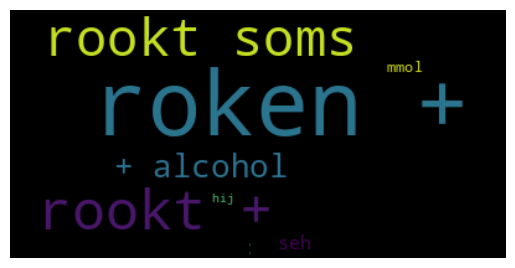

In [53]:
current_user_dictionary = {row['feature']:(row['eval'] * -1) for index, row in feature_importance.iterrows()}
wc = WordCloud().generate_from_frequencies(current_user_dictionary)
plt.imshow(wc, interpolation="bilinear")
plt.axis("off")
plt.show()

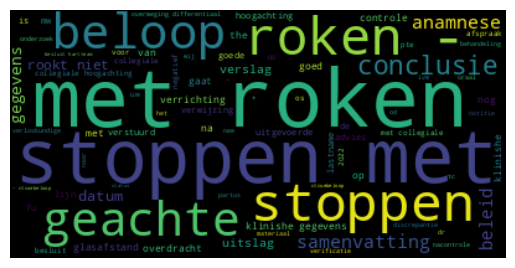

In [54]:
non_user_dictionary = {row['feature']:row['eval'] for index, row in feature_importance.iterrows()}
wc = WordCloud().generate_from_frequencies(non_user_dictionary)
plt.imshow(wc, interpolation="bilinear")
plt.axis("off")
plt.show()

0.994958661020367


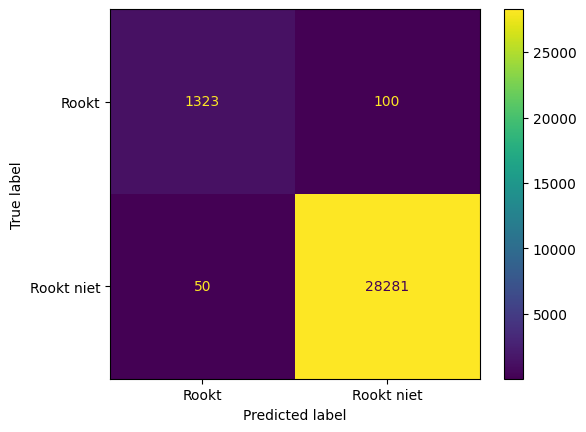

              precision    recall  f1-score   support

       Rookt       0.96      0.93      0.95      1423
  Rookt niet       1.00      1.00      1.00     28331

    accuracy                           0.99     29754
   macro avg       0.98      0.96      0.97     29754
weighted avg       0.99      0.99      0.99     29754



In [12]:
predicted_nb = model.predict(smoking_x_test)
print(np.mean(predicted_nb == smoking_y_test))
cm = confusion_matrix(smoking_y_test, predicted_nb)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              display_labels=model.classes_)
disp.plot()

plt.show()
print(metrics.classification_report(smoking_y_test, predicted_nb,
    target_names=model.classes_))

In [18]:
predicted_nb_df = model.decision_function(smoking_x_test)
x_test_probs = pd.DataFrame(smoking_x_test, columns=['text'])
x_test_probs['eval'] = predicted_nb_df
x_test_probs['predicted_label'] = predicted_nb
x_test_probs['true_label'] = smoking_y_test

In [20]:
pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_rows', None)

In [25]:
x_test_probs_merged = x_test_probs.merge(original_smoking_corpus['text'], left_index=True, right_index=True, suffixes = ['_processed', '_original'])

In [26]:
x_test_probs_merged[x_test_probs_merged['predicted_label'] == 'Rookt niet'].sort_values(by=['eval'], ascending=True).head(100)

text_processed  \
9573                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                      - aankomst seh: 12-07-2015  22:41 indicatie: obs. bu

In [27]:
x_test_probs_merged[x_test_probs_merged['predicted_label'] == 'Rookt'].sort_values(by=['eval'], ascending=False).head(100)

text_processed  \
21289                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                         

# Drinking experiment 1

In [55]:
corpus, corpus_backup = create_preprocess_corpus("../../input_data/drinking/labelled_drinking.csv", "alcohol_report_content", "alcohol_answer_label", skip_rows=[227225])

In [56]:
original_corpus, _ = create_original_corpus("../../input_data/drinking/labelled_drinking.csv", "alcohol_report_content", "alcohol_answer_label", skip_rows=[227225])

In [57]:
model = pickle.load(open('../best_models/best_drinking_ex1.pkl', 'rb'))

In [62]:
ex1_features = model.best_estimator_['tfidf'].get_feature_names_out()
ex1_coef = model.best_estimator_['clf'].coef_
feature_importance = pd.DataFrame(ex1_features, columns=['feature'])
feature_importance['current_user_importance'] = ex1_coef[0]
feature_importance['non_user_importance'] = ex1_coef[1]
feature_importance['nothing_found_importance'] = ex1_coef[2]

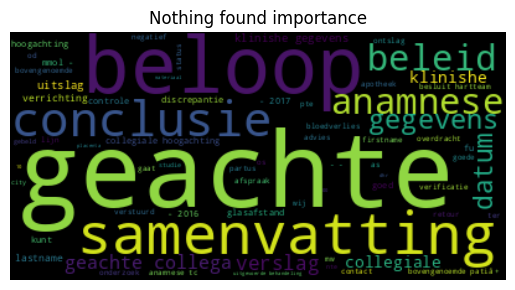

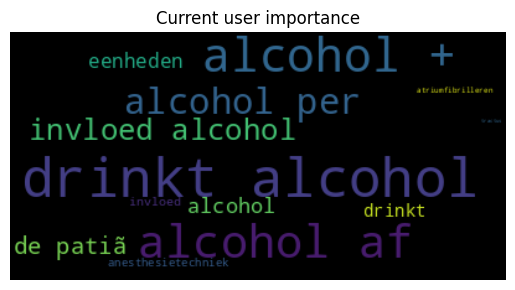

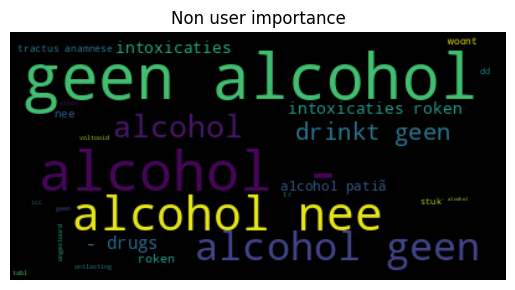

In [63]:
nothing_found_dictionary = {row['feature']:row['nothing_found_importance'] for index, row in feature_importance.iterrows()}
wc = WordCloud().generate_from_frequencies(nothing_found_dictionary)
plt.imshow(wc, interpolation="bilinear")
plt.title('Nothing found importance')
plt.axis("off")
plt.show()

current_user_dictionary = {row['feature']:row['current_user_importance'] for index, row in feature_importance.iterrows()}
wc = WordCloud().generate_from_frequencies(current_user_dictionary)
plt.imshow(wc, interpolation="bilinear")
plt.title('Current user importance')
plt.axis("off")
plt.show()

non_user_dictionary = {row['feature']:row['non_user_importance'] for index, row in feature_importance.iterrows()}
wc = WordCloud().generate_from_frequencies(non_user_dictionary)
plt.imshow(wc, interpolation="bilinear")
plt.title('Non user importance')
plt.axis("off")
plt.show()

In [8]:
_, x_test, _, y_test = train_test_split(corpus['text'], corpus['label'], test_size=0.2, random_state=50)

0.9953551721729412


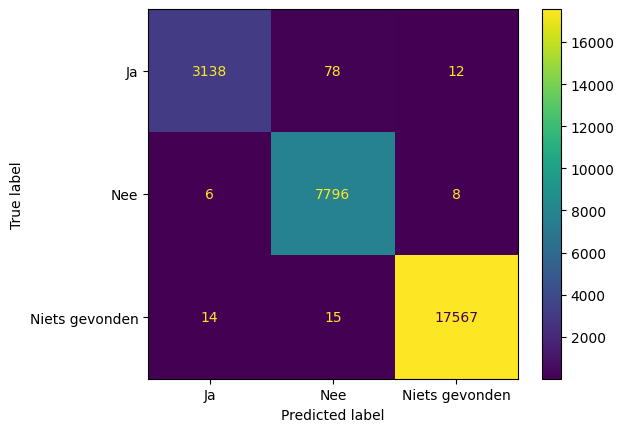

                precision    recall  f1-score   support

            Ja       0.99      0.97      0.98      3228
           Nee       0.99      1.00      0.99      7810
Niets gevonden       1.00      1.00      1.00     17596

      accuracy                           1.00     28634
     macro avg       0.99      0.99      0.99     28634
  weighted avg       1.00      1.00      1.00     28634



In [9]:
predicted_nb = model.predict(x_test)
print(np.mean(predicted_nb == y_test))
cm = confusion_matrix(y_test, predicted_nb)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              display_labels=model.classes_)
disp.plot()

plt.show()
print(metrics.classification_report(y_test, predicted_nb,
    target_names=model.classes_))

In [13]:
model.classes_

array(['Ja', 'Nee', 'Niets gevonden'], dtype='<U14')

In [14]:
predicted_nb_df = model.decision_function(x_test)
x_test_probs = pd.DataFrame(x_test, columns=['text'])
x_test_probs['current_user_eval'] = [x[0] for x in predicted_nb_df]
x_test_probs['non_user_eval'] = [x[1] for x in predicted_nb_df]
x_test_probs['nothing_found_eval'] = [x[2] for x in predicted_nb_df]
x_test_probs['predicted_label'] = predicted_nb
x_test_probs['true_label'] = y_test

In [15]:
pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_rows', None)

In [16]:
x_test_probs_merged = x_test_probs.merge(original_corpus['text'], left_index=True, right_index=True, suffixes = ['_processed', '_original'])

In [17]:
x_test_probs_merged[x_test_probs_merged['predicted_label'] == 'Nee'].sort_values(by=['current_user_eval'], ascending=False).head(100)

,text_processed,current_user_eval,non_user_eval,nothing_found_eval,predicted_label,true_label,text_original
133240,intoxicaties: roken- roken: ja; soort tabak: shag; aantal shag per dag: 25; alcohol- alcohol: gestopt; gestopt met alcohol sinds: 2010; opmerkingen alcohol: voorheen minstens 10 eh alcohol per dag.;,6.349491,12.213848,-32.561963,Nee,Nee,Intoxicaties: \tRoken- Roken: ja; Soort tabak: shag; Aantal shag per dag: 25; Alcohol- Alcohol: gestopt; Gestopt met alcohol sinds: 2010; Opmerkingen alcohol: Voorheen minstens 10 EH alcohol per dag.;
70091,beloop: beloop: patiã©nt telefonisch gesproken. lab uitslag doorgegeven. gebruikt geen alcohol. per orde dr 't hoen dosering naar 30 mg. recept volgt. krijgt wel meer bultjes. indien nodig langer door lagere dosering. tc 1 maand met lab v.t.v. verstuurd.,2.447804,4.579001,-5.675915,Nee,Nee,Beloop: \tBeloop: PatiÃ©nt telefonisch gesproken.\tLab uitslag doorgegeven.\tGebruikt geen alcohol.\tPer orde dr 't Hoen dosering naar 30 mg.\tRecept volgt.\tKrijgt wel meer bultjes. Indien nodig langer door lagere dosering.\tTC 1 maand met lab v.t.v. verstuurd.
194210,"anamnese: verkort consult: aandachtspunten uit pre-operatieve screening: 1. relevante voorgeschiedenis 2020-10 iud verwijderd. 2018 hidradenitis 2017 meer gecompliceerde neurolysen 2017 chronische hoofdpijn 2016 hiv-infectie 2007 opname in een fase huis; begeleid wonen 2007 switch naar kaletra, combivir 2006/2005 longembolie 2003 intra uteruiene vruchtdood bij amenorrhoeduur 25wk 2002 intra uteruine groeiretardatie ondanks fraxiparine, spoedsectio 35wk 1995 intra uteriene vruchtdood 21 wk, dvt kraambed 1995 dvt 1994 mammareductie 1993 partus 1900 sectio 2x anamnese: indicatie â¢pok gyn onder sedatiealgemene anamnesemedische verklaring patiã«nt: beroep/werkzaamheden: geen allergieã«n: huisstofmijt of hooikoorts/pollenmedicatiefamiliaire ziektes: overigonder behandeling bij internist, hiv , bij de gynaecoloog /baarmoedereerder geopereerd, 1993 in het rode kruis ziekenhuis [city]/ 2 keer keizersnee gehad .in den helder en amc amsterdamcts 3jr geleden. anesthesie: algeheel, overigwagenziekte/reisziektebekend met bloedtransfusie/irregulaire antistoffenintoxicatiesde patiã«nt rookt sinds 1900, (10 sigaretten per dag). opmerkingen mbt roken: 25 jaar gestopt.de patiã«nt drinkt alcohol (bier), af en toe niet altijd.opmerkingen mbt alcohol: geen alcohol verslaving.de patiã«nt gebruikt geen drugs. tractus circulatoriusmet-score 5, dyspnoe-score 0hypertensieaandoening bloedvatenorthopneutractus digestivusmaagulcusoverige maagklachtentractus endocrinologicusdiabetes, orale medicatie (bijv. tabletten)tractus overige internetrombosebeen/ longembolie, 2005-2006 long en dvtsyndroom/niet gevraagde ziekte: nvt kijk mijn medice dossieradditionele anamneseoverige opmerkingen: geenclaustrofobie ,erg angstig begeleiding patiã«nt is op de hoogte van en akkoord met de aard en het doel van de voorgenomen ingreep. vragen over anesthesie: nee lichamelijk onderzoek: nekmobiliteit: normaal ('sniffing air')moeilijkheid intubatie: niet te beoordelenmoet gewogen worden bij opname ! conclusie: asa-score: 2 voorgestelde anesthesietechniek (specialist): sedatievoorkeur anesthesie patiã«nt: algeheelgeplande anesthesietechniek: procedurele analgosedatievoor een actueel antistollingsbeleid zie epd dashboard en medicatielijstnuchterbeleid: nuchterinr neehuidige opnamestatus: opgeroepenvragen van patiã«nt: neeoverige opmerkingen anesthesie: heeft veel oorbellen gaat deze verwijderen zegt ze.heeft nog vragen over medicijngebruik verwezen naar behandelaarinformed consent: verstrekte informatie:- peri-operatieve monitoring- nuchter beleid besproken- geplande anesthesietechniek en alternatieven besproken- uitleg gang van zaken m.b.t. premedicatie/ voorbereiding en verkoeverkamer- geplande postoperatieve beleid (o.a. pijnbeleid) besproken- risico''s besproken (o.a. tandschade)- wettelijke vertegenwoordiger heeft de informatie begrepen (indien van toepassing)- kiest voor/ 

In [17]:
x_test_probs_merged[x_test_probs_merged['predicted_label'] == 'Nee'].sort_values(by=['current_user_eval'], ascending=False).head(100)

,text_processed,current_user_eval,non_user_eval,nothing_found_eval,predicted_label,true_label,text_original
133240,intoxicaties: roken- roken: ja; soort tabak: shag; aantal shag per dag: 25; alcohol- alcohol: gestopt; gestopt met alcohol sinds: 2010; opmerkingen alcohol: voorheen minstens 10 eh alcohol per dag.;,6.349491,12.213848,-32.561963,Nee,Nee,Intoxicaties: \tRoken- Roken: ja; Soort tabak: shag; Aantal shag per dag: 25; Alcohol- Alcohol: gestopt; Gestopt met alcohol sinds: 2010; Opmerkingen alcohol: Voorheen minstens 10 EH alcohol per dag.;
70091,beloop: beloop: patiã©nt telefonisch gesproken. lab uitslag doorgegeven. gebruikt geen alcohol. per orde dr 't hoen dosering naar 30 mg. recept volgt. krijgt wel meer bultjes. indien nodig langer door lagere dosering. tc 1 maand met lab v.t.v. verstuurd.,2.447804,4.579001,-5.675915,Nee,Nee,Beloop: \tBeloop: PatiÃ©nt telefonisch gesproken.\tLab uitslag doorgegeven.\tGebruikt geen alcohol.\tPer orde dr 't Hoen dosering naar 30 mg.\tRecept volgt.\tKrijgt wel meer bultjes. Indien nodig langer door lagere dosering.\tTC 1 maand met lab v.t.v. verstuurd.
194210,"anamnese: verkort consult: aandachtspunten uit pre-operatieve screening: 1. relevante voorgeschiedenis 2020-10 iud verwijderd. 2018 hidradenitis 2017 meer gecompliceerde neurolysen 2017 chronische hoofdpijn 2016 hiv-infectie 2007 opname in een fase huis; begeleid wonen 2007 switch naar kaletra, combivir 2006/2005 longembolie 2003 intra uteruiene vruchtdood bij amenorrhoeduur 25wk 2002 intra uteruine groeiretardatie ondanks fraxiparine, spoedsectio 35wk 1995 intra uteriene vruchtdood 21 wk, dvt kraambed 1995 dvt 1994 mammareductie 1993 partus 1900 sectio 2x anamnese: indicatie â¢pok gyn onder sedatiealgemene anamnesemedische verklaring patiã«nt: beroep/werkzaamheden: geen allergieã«n: huisstofmijt of hooikoorts/pollenmedicatiefamiliaire ziektes: overigonder behandeling bij internist, hiv , bij de gynaecoloog /baarmoedereerder geopereerd, 1993 in het rode kruis ziekenhuis [city]/ 2 keer keizersnee gehad .in den helder en amc amsterdamcts 3jr geleden. anesthesie: algeheel, overigwagenziekte/reisziektebekend met bloedtransfusie/irregulaire antistoffenintoxicatiesde patiã«nt rookt sinds 1900, (10 sigaretten per dag). opmerkingen mbt roken: 25 jaar gestopt.de patiã«nt drinkt alcohol (bier), af en toe niet altijd.opmerkingen mbt alcohol: geen alcohol verslaving.de patiã«nt gebruikt geen drugs. tractus circulatoriusmet-score 5, dyspnoe-score 0hypertensieaandoening bloedvatenorthopneutractus digestivusmaagulcusoverige maagklachtentractus endocrinologicusdiabetes, orale medicatie (bijv. tabletten)tractus overige internetrombosebeen/ longembolie, 2005-2006 long en dvtsyndroom/niet gevraagde ziekte: nvt kijk mijn medice dossieradditionele anamneseoverige opmerkingen: geenclaustrofobie ,erg angstig begeleiding patiã«nt is op de hoogte van en akkoord met de aard en het doel van de voorgenomen ingreep. vragen over anesthesie: nee lichamelijk onderzoek: nekmobiliteit: normaal ('sniffing air')moeilijkheid intubatie: niet te beoordelenmoet gewogen worden bij opname ! conclusie: asa-score: 2 voorgestelde anesthesietechniek (specialist): sedatievoorkeur anesthesie patiã«nt: algeheelgeplande anesthesietechniek: procedurele analgosedatievoor een actueel antistollingsbeleid zie epd dashboard en medicatielijstnuchterbeleid: nuchterinr neehuidige opnamestatus: opgeroepenvragen van patiã«nt: neeoverige opmerkingen anesthesie: heeft veel oorbellen gaat deze verwijderen zegt ze.heeft nog vragen over medicijngebruik verwezen naar behandelaarinformed consent: verstrekte informatie:- peri-operatieve monitoring- nuchter beleid besproken- geplande anesthesietechniek en alternatieven besproken- uitleg gang van zaken m.b.t. premedicatie/ voorbereiding en verkoeverkamer- geplande postoperatieve beleid (o.a. pijnbeleid) besproken- risico''s besproken (o.a. tandschade)- wettelijke vertegenwoordiger heeft de informatie begrepen (indien van toepassing)- kiest voor/ 

In [17]:
x_test_probs_merged[x_test_probs_merged['predicted_label'] == 'Nee'].sort_values(by=['current_user_eval'], ascending=False).head(100)

,text_processed,current_user_eval,non_user_eval,nothing_found_eval,predicted_label,true_label,text_original
133240,intoxicaties: roken- roken: ja; soort tabak: shag; aantal shag per dag: 25; alcohol- alcohol: gestopt; gestopt met alcohol sinds: 2010; opmerkingen alcohol: voorheen minstens 10 eh alcohol per dag.;,6.349491,12.213848,-32.561963,Nee,Nee,Intoxicaties: \tRoken- Roken: ja; Soort tabak: shag; Aantal shag per dag: 25; Alcohol- Alcohol: gestopt; Gestopt met alcohol sinds: 2010; Opmerkingen alcohol: Voorheen minstens 10 EH alcohol per dag.;
70091,beloop: beloop: patiã©nt telefonisch gesproken. lab uitslag doorgegeven. gebruikt geen alcohol. per orde dr 't hoen dosering naar 30 mg. recept volgt. krijgt wel meer bultjes. indien nodig langer door lagere dosering. tc 1 maand met lab v.t.v. verstuurd.,2.447804,4.579001,-5.675915,Nee,Nee,Beloop: \tBeloop: PatiÃ©nt telefonisch gesproken.\tLab uitslag doorgegeven.\tGebruikt geen alcohol.\tPer orde dr 't Hoen dosering naar 30 mg.\tRecept volgt.\tKrijgt wel meer bultjes. Indien nodig langer door lagere dosering.\tTC 1 maand met lab v.t.v. verstuurd.
194210,"anamnese: verkort consult: aandachtspunten uit pre-operatieve screening: 1. relevante voorgeschiedenis 2020-10 iud verwijderd. 2018 hidradenitis 2017 meer gecompliceerde neurolysen 2017 chronische hoofdpijn 2016 hiv-infectie 2007 opname in een fase huis; begeleid wonen 2007 switch naar kaletra, combivir 2006/2005 longembolie 2003 intra uteruiene vruchtdood bij amenorrhoeduur 25wk 2002 intra uteruine groeiretardatie ondanks fraxiparine, spoedsectio 35wk 1995 intra uteriene vruchtdood 21 wk, dvt kraambed 1995 dvt 1994 mammareductie 1993 partus 1900 sectio 2x anamnese: indicatie â¢pok gyn onder sedatiealgemene anamnesemedische verklaring patiã«nt: beroep/werkzaamheden: geen allergieã«n: huisstofmijt of hooikoorts/pollenmedicatiefamiliaire ziektes: overigonder behandeling bij internist, hiv , bij de gynaecoloog /baarmoedereerder geopereerd, 1993 in het rode kruis ziekenhuis [city]/ 2 keer keizersnee gehad .in den helder en amc amsterdamcts 3jr geleden. anesthesie: algeheel, overigwagenziekte/reisziektebekend met bloedtransfusie/irregulaire antistoffenintoxicatiesde patiã«nt rookt sinds 1900, (10 sigaretten per dag). opmerkingen mbt roken: 25 jaar gestopt.de patiã«nt drinkt alcohol (bier), af en toe niet altijd.opmerkingen mbt alcohol: geen alcohol verslaving.de patiã«nt gebruikt geen drugs. tractus circulatoriusmet-score 5, dyspnoe-score 0hypertensieaandoening bloedvatenorthopneutractus digestivusmaagulcusoverige maagklachtentractus endocrinologicusdiabetes, orale medicatie (bijv. tabletten)tractus overige internetrombosebeen/ longembolie, 2005-2006 long en dvtsyndroom/niet gevraagde ziekte: nvt kijk mijn medice dossieradditionele anamneseoverige opmerkingen: geenclaustrofobie ,erg angstig begeleiding patiã«nt is op de hoogte van en akkoord met de aard en het doel van de voorgenomen ingreep. vragen over anesthesie: nee lichamelijk onderzoek: nekmobiliteit: normaal ('sniffing air')moeilijkheid intubatie: niet te beoordelenmoet gewogen worden bij opname ! conclusie: asa-score: 2 voorgestelde anesthesietechniek (specialist): sedatievoorkeur anesthesie patiã«nt: algeheelgeplande anesthesietechniek: procedurele analgosedatievoor een actueel antistollingsbeleid zie epd dashboard en medicatielijstnuchterbeleid: nuchterinr neehuidige opnamestatus: opgeroepenvragen van patiã«nt: neeoverige opmerkingen anesthesie: heeft veel oorbellen gaat deze verwijderen zegt ze.heeft nog vragen over medicijngebruik verwezen naar behandelaarinformed consent: verstrekte informatie:- peri-operatieve monitoring- nuchter beleid besproken- geplande anesthesietechniek en alternatieven besproken- uitleg gang van zaken m.b.t. premedicatie/ voorbereiding en verkoeverkamer- geplande postoperatieve beleid (o.a. pijnbeleid) besproken- risico''s besproken (o.a. tandschade)- wettelijke vertegenwoordiger heeft de informatie begrepen (indien van toepassing)- kiest voor/ 

In [17]:
x_test_probs_merged[x_test_probs_merged['predicted_label'] == 'Nee'].sort_values(by=['current_user_eval'], ascending=False).head(100)

,text_processed,current_user_eval,non_user_eval,nothing_found_eval,predicted_label,true_label,text_original
133240,intoxicaties: roken- roken: ja; soort tabak: shag; aantal shag per dag: 25; alcohol- alcohol: gestopt; gestopt met alcohol sinds: 2010; opmerkingen alcohol: voorheen minstens 10 eh alcohol per dag.;,6.349491,12.213848,-32.561963,Nee,Nee,Intoxicaties: \tRoken- Roken: ja; Soort tabak: shag; Aantal shag per dag: 25; Alcohol- Alcohol: gestopt; Gestopt met alcohol sinds: 2010; Opmerkingen alcohol: Voorheen minstens 10 EH alcohol per dag.;
70091,beloop: beloop: patiã©nt telefonisch gesproken. lab uitslag doorgegeven. gebruikt geen alcohol. per orde dr 't hoen dosering naar 30 mg. recept volgt. krijgt wel meer bultjes. indien nodig langer door lagere dosering. tc 1 maand met lab v.t.v. verstuurd.,2.447804,4.579001,-5.675915,Nee,Nee,Beloop: \tBeloop: PatiÃ©nt telefonisch gesproken.\tLab uitslag doorgegeven.\tGebruikt geen alcohol.\tPer orde dr 't Hoen dosering naar 30 mg.\tRecept volgt.\tKrijgt wel meer bultjes. Indien nodig langer door lagere dosering.\tTC 1 maand met lab v.t.v. verstuurd.
194210,"anamnese: verkort consult: aandachtspunten uit pre-operatieve screening: 1. relevante voorgeschiedenis 2020-10 iud verwijderd. 2018 hidradenitis 2017 meer gecompliceerde neurolysen 2017 chronische hoofdpijn 2016 hiv-infectie 2007 opname in een fase huis; begeleid wonen 2007 switch naar kaletra, combivir 2006/2005 longembolie 2003 intra uteruiene vruchtdood bij amenorrhoeduur 25wk 2002 intra uteruine groeiretardatie ondanks fraxiparine, spoedsectio 35wk 1995 intra uteriene vruchtdood 21 wk, dvt kraambed 1995 dvt 1994 mammareductie 1993 partus 1900 sectio 2x anamnese: indicatie â¢pok gyn onder sedatiealgemene anamnesemedische verklaring patiã«nt: beroep/werkzaamheden: geen allergieã«n: huisstofmijt of hooikoorts/pollenmedicatiefamiliaire ziektes: overigonder behandeling bij internist, hiv , bij de gynaecoloog /baarmoedereerder geopereerd, 1993 in het rode kruis ziekenhuis [city]/ 2 keer keizersnee gehad .in den helder en amc amsterdamcts 3jr geleden. anesthesie: algeheel, overigwagenziekte/reisziektebekend met bloedtransfusie/irregulaire antistoffenintoxicatiesde patiã«nt rookt sinds 1900, (10 sigaretten per dag). opmerkingen mbt roken: 25 jaar gestopt.de patiã«nt drinkt alcohol (bier), af en toe niet altijd.opmerkingen mbt alcohol: geen alcohol verslaving.de patiã«nt gebruikt geen drugs. tractus circulatoriusmet-score 5, dyspnoe-score 0hypertensieaandoening bloedvatenorthopneutractus digestivusmaagulcusoverige maagklachtentractus endocrinologicusdiabetes, orale medicatie (bijv. tabletten)tractus overige internetrombosebeen/ longembolie, 2005-2006 long en dvtsyndroom/niet gevraagde ziekte: nvt kijk mijn medice dossieradditionele anamneseoverige opmerkingen: geenclaustrofobie ,erg angstig begeleiding patiã«nt is op de hoogte van en akkoord met de aard en het doel van de voorgenomen ingreep. vragen over anesthesie: nee lichamelijk onderzoek: nekmobiliteit: normaal ('sniffing air')moeilijkheid intubatie: niet te beoordelenmoet gewogen worden bij opname ! conclusie: asa-score: 2 voorgestelde anesthesietechniek (specialist): sedatievoorkeur anesthesie patiã«nt: algeheelgeplande anesthesietechniek: procedurele analgosedatievoor een actueel antistollingsbeleid zie epd dashboard en medicatielijstnuchterbeleid: nuchterinr neehuidige opnamestatus: opgeroepenvragen van patiã«nt: neeoverige opmerkingen anesthesie: heeft veel oorbellen gaat deze verwijderen zegt ze.heeft nog vragen over medicijngebruik verwezen naar behandelaarinformed consent: verstrekte informatie:- peri-operatieve monitoring- nuchter beleid besproken- geplande anesthesietechniek en alternatieven besproken- uitleg gang van zaken m.b.t. premedicatie/ voorbereiding en verkoeverkamer- geplande postoperatieve beleid (o.a. pijnbeleid) besproken- risico''s besproken (o.a. tandschade)- wettelijke vertegenwoordiger heeft de informatie begrepen (indien van toepassing)- kiest voor/ 

In [18]:
x_test_probs_merged[x_test_probs_merged['predicted_label'] == 'Ja'].sort_values(by=['non_user_eval'], ascending=False).head(100)

,text_processed,current_user_eval,non_user_eval,nothing_found_eval,predicted_label,true_label,text_original
75135,"anamnese: semi-arts: b khalifa supervisor: l van de voort allergieã«n: schaal- en schelpdieren medicatie: geen voorgeschiedenis: 2022 (11) alcohol intoxicatie 2018 maagperforatie alcohol abuses intoxicatie met drugs (onduidelijk welke) anamnese: sinds jaren bekend met buikpijn in de maagregio, in 2018 maagperforatie gehad. nu sinds 3 dagen toename buikpijnklachten boven in de buik, gaat aanvalsgewijs en is brandend van aard. straalt niet uit. is hierbij erg misselijk. heeft vaker gebraakt, niet gekeken of hier bloed bij zat. ontlasting drie dagen geleden voor het laats gehad, was toen diarree, op straat gebeurd pt heeft niet gekeken of daar bloed bij zat. plassen geen klachten. geen andere klachten momenteel. sociaal: woont bij leger des heils intoxicaties: alcohol ++, roken: dagelijks 1 pakje, drugs: cocaine en marihuana. patiã«nt zegt vandaag geen alcohol te hebben gedrronken, geen drugs gebruikt. lichamelijk onderzoek: lichamelijk onderzoek controles: t 37.5, ah 16/min, sat 98% bij kl, rr 146/100, hr 85 bpm alg: oogt niet pijnlijk in rust, niet dyspnoeisch. rustige ademhaling. hh: vochtige slijmvliezen cor: s1s2, geen souffles pulm: vag, geen bijgeluiden abd: slanke buik. spaarzame peristaltiek. wisselend tympaan. drukpijn met name t.p.v. maagregio. geen loslaatpijn. geen geprikkelde buik. aanvullend onderzoek: laboratorium 01-12-2022 ureum 2.8 mmol/l kreatinine 67 âµmol/l geschatte gfr (ckd-epi) 119 ml/min/1.73m^2 calcium 2.49 mmol/l natrium 135 mmol/l kalium (plasma) 3.8 mmol/l chloride 94 mmol/l asat 23 u/l alat 18 u/l ld 190 u/l ggt 72 u/l bilirubine totaal 5 âµmol/l alkalische fosfatase (af) 105 u/l totaal eiwit 77 g/l albumine 45 g/l ck 171 u/l lipase 14 u/l hemoglobine 10.7 mmol/l hematocriet 0.50 l/l erythrocyten 6.0 x10^12/l mcv 84 fl mch 1.79 fmol rdw 12.5 % trombocyten 278 x10^9/l leucocyten 5.9 x10^9/l glucose 5.9 mmol/l crp <1 mg/l conclusie: conclusie: 34-jarige man, bekend met middelenmisbruik en maagperforatie in 2018 1. buikpijn sinds 3 dagen dd ulcus dd gastritis. lage infectieparameters. geen verdenking maagperforatie. geen verdenking acute pancreatitis (lipase 14). beleid: beleid: medebeoordeeld door l. van de voort (seh-arts): - omeprazol 1dd1 40 mg - advies aanmelden bij een huisartsenpraktijk",1.806797,1.733973,-7.917240,Ja,Ja,"Anamnese: \tSemi-arts: B Khalifa\tSupervisor: L van de Voort\t\tAllergieÃ«n: schaal- en schelpdieren\t\tMedicatie: geen\t\tVoorgeschiedenis:\t2022 (11) alcohol intoxicatie\t2018 maagperforatie\tAlcohol abuses\tIntoxicatie met drugs (onduidelijk welke)\t\tAnamnese:\tSinds jaren bekend met buikpijn in de maagregio, in 2018 maagperforatie gehad. Nu sinds 3 dagen toename buikpijnklachten boven in de buik, gaat aanvalsgewijs en is brandend van aard. Straalt niet uit. Is hierbij erg misselijk. Heeft vaker gebraakt, niet gekeken of hier bloed bij zat. Ontlasting drie dagen geleden voor het laats gehad, was toen diarree, op straat gebeurd pt heeft niet gekeken of daar bloed bij zat. Plassen geen klachten. Geen andere klachten momenteel.\t\tSociaal: woont bij leger des heils\tIntoxicaties: Alcohol ++, roken: dagelijks 1 pakje, drugs: cocaine en marihuana. PatiÃ«nt zegt vandaag geen alcohol te hebben gedrronken, geen drugs gebruikt.\t\t\tLichamelijk onderzoek: \tLichamelijk onderzoek\tControles: T 37.5, AH 16/min, Sat 98% bij KL, RR 146/100, HR 85 bpm\tAlg: oogt niet pijnlijk in rust, niet dyspnoeisch. Rustige ademhaling.\tHH: vochtige slijmvliezen\tCor: S1S2, geen souffles\tPulm: vag, geen bijgeluiden\tAbd: slanke buik. Spaarzame peristaltiek. Wisselend tympaan. Drukpijn met name t.p.v. maagregio. Geen loslaatpijn. Geen geprikkelde buik.\t\t\tAanvullend onderzoek: \tLaboratorium 01-12-2022\t\t\tUreum\t2.8\tmmol/L\tKreatinine\t67\tÂµmol/L\tgeschatte GFR (CKD-EPI)\t119\tml/min/1.73m^2\tCalcium\t2.49\tmmol/L\tNatrium\t135\tmmol/L\tKalium (plasma)\t3.8\tmmol/l\tChloride\t94\tmm

# Drinking experiment 2

In [64]:
corpus, corpus_backup = create_preprocess_corpus("../../input_data/drinking/labelled_drinking.csv", "alcohol_report_content", "alcohol_answer_label", second_experiment=True, skip_rows=[227225])

In [65]:
original_corpus, _ = create_original_corpus("../../input_data/drinking/labelled_drinking.csv", "alcohol_report_content", "alcohol_answer_label", skip_rows=[227225])

In [66]:
model = pickle.load(open('../best_models/best_drinking_ex2.pkl', 'rb'))

In [67]:
ex1_features = model.best_estimator_['tfidf'].get_feature_names_out()
ex1_coef = model.best_estimator_['clf'].coef_
feature_importance = pd.DataFrame(ex1_features, columns=['feature'])
ex1_coef.shape
feature_importance['eval'] = ex1_coef[0]

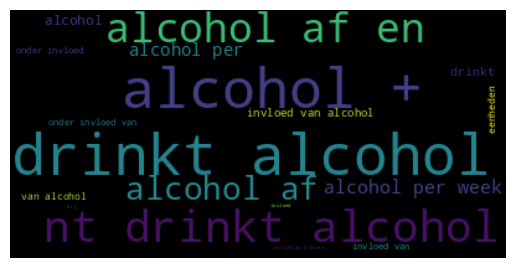

In [68]:
current_user_dictionary = {row['feature']:(row['eval'] * -1) for index, row in feature_importance.iterrows()}
wc = WordCloud().generate_from_frequencies(current_user_dictionary)
plt.imshow(wc, interpolation="bilinear")
plt.axis("off")
plt.show()

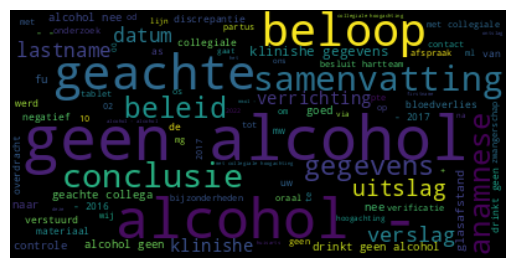

In [69]:
non_user_dictionary = {row['feature']:row['eval'] for index, row in feature_importance.iterrows()}
wc = WordCloud().generate_from_frequencies(non_user_dictionary)
plt.imshow(wc, interpolation="bilinear")
plt.axis("off")
plt.show()

In [6]:
_, x_test, _, y_test = train_test_split(corpus['text'], corpus['label'], test_size=0.2, random_state=50)

0.9980792065376825


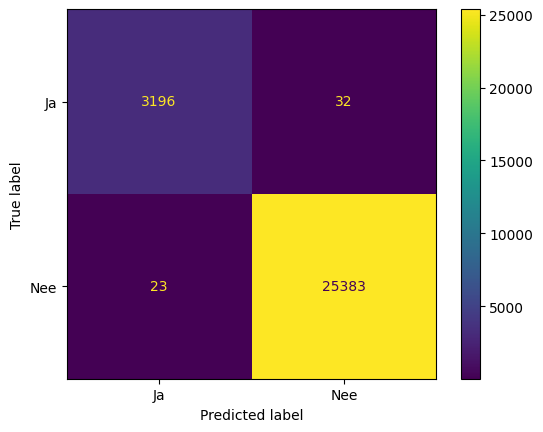

              precision    recall  f1-score   support

          Ja       0.99      0.99      0.99      3228
         Nee       1.00      1.00      1.00     25406

    accuracy                           1.00     28634
   macro avg       1.00      0.99      1.00     28634
weighted avg       1.00      1.00      1.00     28634



In [7]:
predicted_nb = model.predict(x_test)
print(np.mean(predicted_nb == y_test))
cm = confusion_matrix(y_test, predicted_nb)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              display_labels=model.classes_)
disp.plot()

plt.show()
print(metrics.classification_report(y_test, predicted_nb,
    target_names=model.classes_))

In [8]:
model.classes_

array(['Ja', 'Nee'], dtype='<U3')

In [9]:
predicted_nb_df = model.decision_function(x_test)
x_test_probs = pd.DataFrame(x_test, columns=['text'])
x_test_probs['eval'] = predicted_nb_df
x_test_probs['predicted_label'] = predicted_nb
x_test_probs['true_label'] = y_test

In [10]:
pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_rows', None)

In [11]:
x_test_probs_merged = x_test_probs.merge(original_corpus['text'], left_index=True, right_index=True, suffixes = ['_processed', '_original'])

In [18]:
top100_score_yes_pred_no = x_test_probs_merged[x_test_probs_merged['predicted_label'] == 'Nee'].sort_values(by=['eval'], ascending=True)[['eval', 'text_original']].head(100)

In [19]:
top100_score_yes_pred_no

eval  \
219845  0.002968   
52989   0.009701   
57593   0.012387   
2329    0.028389   
120057  0.030382   
50127   0.031703   
152985  0.033155   
102664  0.033364   
80431   0.033427   
196015  0.038229   
36569   0.038325   
24178   0.039478   
131872  0.040532   
60070   0.041177   
14518   0.042139   
28180   0.043023   
31331   0.043120   
210421  0.047359   
119886  0.052298   
209634  0.053873   
99420   0.055922   
3015    0.056265   
74274   0.057491   
45480   0.061561   
3235    0.062702   
57228   0.066484   
31025   0.068313   
60376   0.075027   
83285   0.080086   
146294  0.081996   
5760    0.084837   
82000   0.087349   
86240   0.088833   
27182   0.089163   
151827  0.093369   
26684   0.093377   
45753   0.096203   
35293   0.105443   
27239   0.108224   
224235  0.112179   
124609  0.118940   
193876  0.123002   
32473   0.123952   
20385   0.124048   
117639  0.127941   
10905   0.127984   
23412   0.130134   
124274  0.131556   
224585  0.134211   
96301   0.135038   
96304   0.135062   
54759   0.136823   
109390  0.138341   
112483  0.139081   
123923  0.139654   
95775   0.140108   
21732   0.142801   
53831   0.150810   
187561  0.151769   
1039    0.152932   
80592   0.153329   
108972  0.154915   
182378  0.157728   
101686  0.165136   
15994   0.167235   
135890  0.167403   
122801  0.171240   
219831  0.173268   
82134   0.173699   
126311  0.176948   
121049  0.178438   
113033  0.180218   
10079   0.180640   
121024  0.181014   
149206  0.182009   
173118  0.182414   
24864   0.183913   
124161  0.184822   
35229   0.187174   
161444  0.188255   
120574  0.188398   
75285   0.189546   
176699  0.192220   
9329    0.195440   
106595  0.195808   
223746  0.197474   
209388  0.200006   
106524  0.201310   
117020  0.203226   
52926   0.203582   
55343   0.204635   
146872  0.205606   
99790   0.206587   
72407   0.214559   
25795   0.214578   
162194  0.215673   
96704   0.223430   
61844   0.231985   
31511   0.233148   
207603  0.235540   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                       

In [20]:
top100_score_no_pred_yes = x_test_probs_merged[x_test_probs_merged['predicted_label'] == 'Ja'].sort_values(by=['eval'], ascending=False)[['eval', 'text_original']].head(100)

In [21]:
top100_score_no_pred_yes

eval  \
78270   0.000000   
19118   0.000000   
50690   0.000000   
196568  0.000000   
2776    0.000000   
1036    0.000000   
7564    0.000000   
111956 -0.020719   
44873  -0.022950   
86288  -0.048010   
100129 -0.073458   
38314  -0.078522   
149973 -0.092529   
200508 -0.119296   
5440   -0.124575   
38756  -0.131796   
32838  -0.132620   
219129 -0.140026   
225793 -0.154140   
100742 -0.162881   
97106  -0.190206   
90846  -0.193966   
89890  -0.207322   
90832  -0.208892   
107382 -0.210610   
131847 -0.215992   
39800  -0.245306   
101224 -0.261279   
66888  -0.282613   
201559 -0.287228   
121483 -0.297719   
122213 -0.306318   
49156  -0.313948   
16214  -0.315008   
179360 -0.328559   
215647 -0.343007   
9845   -0.363746   
167394 -0.365290   
36924  -0.372835   
152725 -0.376872   
11744  -0.382442   
111005 -0.387271   
91100  -0.389757   
221017 -0.391128   
40401  -0.403618   
96012  -0.416068   
15307  -0.418027   
91144  -0.422540   
32446  -0.425880   
218237 -0.434303   
2658   -0.434453   
180133 -0.444362   
16055  -0.444520   
217040 -0.445762   
116973 -0.446965   
221784 -0.451392   
116700 -0.455650   
104687 -0.484858   
84256  -0.489473   
46843  -0.497405   
188994 -0.498236   
103208 -0.498322   
112999 -0.499494   
198501 -0.499861   
57951  -0.503109   
99593  -0.516081   
16036  -0.520246   
39868  -0.522824   
30328  -0.526610   
78207  -0.535204   
3735   -0.537774   
51340  -0.538747   
153150 -0.540159   
211125 -0.547102   
39845  -0.552611   
205231 -0.552625   
28837  -0.564093   
21459  -0.566334   
106764 -0.569404   
11850  -0.576044   
104287 -0.579238   
64863  -0.584475   
19585  -0.585070   
86366  -0.586507   
81744  -0.587045   
201505 -0.587431   
9148   -0.588813   
119912 -0.590427   
40560  -0.595859   
155095 -0.599899   
83964  -0.600614   
45644  -0.600932   
53751  -0.601634   
65622  -0.602408   
91077  -0.611812   
78439  -0.614231   
185636 -0.618565   
77355  -0.628666   
161092 -0.635679   
45120  -0.639975   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                       

# Drugs experiment 1

In [70]:
corpus, corpus_backup = create_preprocess_corpus("../../input_data/drugs/labelled_drugs.csv", "drugs_report_content", "drugs_answer_label")

In [71]:
original_corpus, _ = create_original_corpus("../../input_data/drugs/labelled_drugs.csv", "drugs_report_content", "drugs_answer_label")

In [72]:
model = pickle.load(open('../best_models/best_drugs_ex1.pkl', 'rb'))

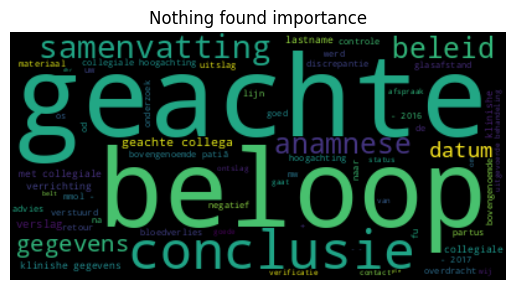

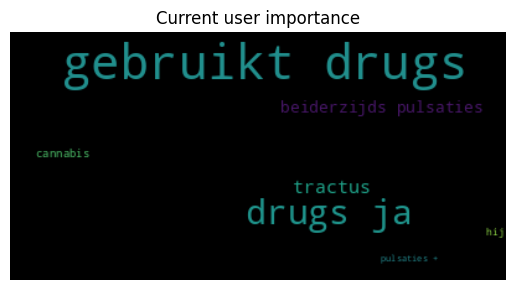

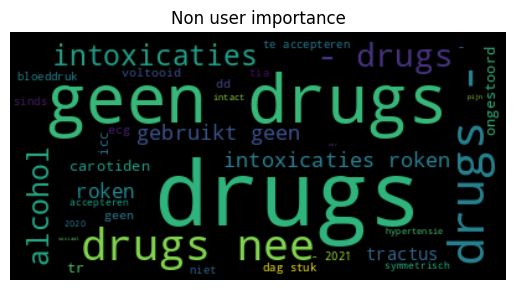

In [73]:
ex1_features = model.best_estimator_['tfidf'].get_feature_names_out()
ex1_coef = model.best_estimator_['clf'].coef_
feature_importance = pd.DataFrame(ex1_features, columns=['feature'])
feature_importance['current_user_importance'] = ex1_coef[0]
feature_importance['non_user_importance'] = ex1_coef[1]
feature_importance['nothing_found_importance'] = ex1_coef[2]

nothing_found_dictionary = {row['feature']:row['nothing_found_importance'] for index, row in feature_importance.iterrows()}
wc = WordCloud().generate_from_frequencies(nothing_found_dictionary)
plt.imshow(wc, interpolation="bilinear")
plt.title('Nothing found importance')
plt.axis("off")
plt.show()

current_user_dictionary = {row['feature']:row['current_user_importance'] for index, row in feature_importance.iterrows()}
wc = WordCloud().generate_from_frequencies(current_user_dictionary)
plt.imshow(wc, interpolation="bilinear")
plt.title('Current user importance')
plt.axis("off")
plt.show()

non_user_dictionary = {row['feature']:row['non_user_importance'] for index, row in feature_importance.iterrows()}
wc = WordCloud().generate_from_frequencies(non_user_dictionary)
plt.imshow(wc, interpolation="bilinear")
plt.title('Non user importance')
plt.axis("off")
plt.show()

In [6]:
_, x_test, _, y_test = train_test_split(corpus['text'], corpus['label'], test_size=0.2, random_state=50)

0.9980405405405406


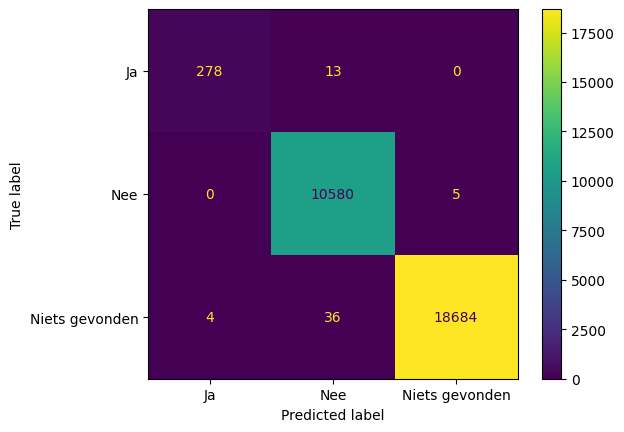

                precision    recall  f1-score   support

            Ja       0.99      0.96      0.97       291
           Nee       1.00      1.00      1.00     10585
Niets gevonden       1.00      1.00      1.00     18724

      accuracy                           1.00     29600
     macro avg       0.99      0.98      0.99     29600
  weighted avg       1.00      1.00      1.00     29600



In [7]:
predicted_nb = model.predict(x_test)
print(np.mean(predicted_nb == y_test))
cm = confusion_matrix(y_test, predicted_nb)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              display_labels=model.classes_)
disp.plot()

plt.show()
print(metrics.classification_report(y_test, predicted_nb,
    target_names=model.classes_))

In [8]:
model.classes_

array(['Ja', 'Nee', 'Niets gevonden'], dtype='<U14')

In [9]:
predicted_nb_df = model.decision_function(x_test)
x_test_probs = pd.DataFrame(x_test, columns=['text'])
x_test_probs['current_user_eval'] = [x[0] for x in predicted_nb_df]
x_test_probs['non_user_eval'] = [x[1] for x in predicted_nb_df]
x_test_probs['nothing_found_eval'] = [x[2] for x in predicted_nb_df]
x_test_probs['predicted_label'] = predicted_nb
x_test_probs['true_label'] = y_test

In [10]:
pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_rows', None)

In [11]:
x_test_probs_merged = x_test_probs.merge(original_corpus['text'], left_index=True, right_index=True, suffixes = ['_processed', '_original'])

In [14]:
top100_score_yes_pred_no = x_test_probs_merged[x_test_probs_merged['predicted_label'] == 'Nee'].sort_values(by=['current_user_eval'], ascending=False)[['non_user_eval','current_user_eval', 'text_original']].head(100)

In [15]:
top100_score_no_pred_yes = x_test_probs_merged[x_test_probs_merged['predicted_label'] == 'Ja'].sort_values(by=['non_user_eval'], ascending=False)[['non_user_eval','current_user_eval', 'text_original']].head(100)

In [23]:
top100_score_yes_pred_no

non_user_eval  current_user_eval  \
129254      28.464560          13.137309   
19364       31.015440          11.579365   
22393        4.037349           3.252725   
80835        4.272679           2.633982   
188838       4.230050           2.046857   
204981       6.668703           1.678887   
143289       5.138654           1.547973   
103310       6.872736           1.341592   
232261       3.865213           1.095609   
211966       1.207519           0.825062   
180064       4.233073           0.526557   
84342        1.630822           0.308166   
758          0.480560           0.064080   
73235        0.237986          -0.039531   
40041        0.144667          -0.044884   
87685        0.097210          -0.046105   
76538        0.102423          -0.048578   
124274       0.118746          -0.056319   
236711      25.770420          -0.057971   
222361       0.106927          -0.076679   
36309        0.052205          -0.082773   
217244       0.000000          -0.154359   
48344        0.079263          -0.156205   
55540        0.092161          -0.198202   
125342       3.874821          -0.266903   
52268        0.064287          -0.288367   
86638        0.014360          -0.301135   
208760       0.430665          -0.301704   
119003       0.155581          -0.350283   
2829         0.299078          -0.374640   
4753         0.111420          -0.377085   
95929        0.218175          -0.381281   
3261         6.292909          -0.409865   
232732       0.721100          -0.415217   
23264        0.449770          -0.420390   
49902        0.228889          -0.455018   
13175        0.867153          -0.478757   
197870       4.242810          -0.497768   
200359       2.028994          -0.503981   
233500       3.927148          -0.540653   
99502        0.074710          -0.546642   
230268       5.105774          -0.548855   
176452       4.303106          -0.559900   
130889       5.460389          -0.583755   
147975       3.924304          -0.590283   
211781       0.550701          -0.594029   
157099       4.043736          -0.597567   
94229        3.958653          -0.604176   
99302        4.028431          -0.609356   
35482        3.221349          -0.621433   
197889       3.590751          -0.623557   
27918        0.068100          -0.626852   
42014        1.709370          -0.626944   
70592        5.117984          -0.630641   
110304       4.799224          -0.636793   
226476       4.106088          -0.640714   
205335       3.827895          -0.643169   
95021       15.193195          -0.652396   
35264        3.319832          -0.652492   
116717       5.531240          -0.652753   
46593       16.824730          -0.664336   
128859      15.208103          -0.664978   
167974       4.084479          -0.665005   
22595        0.003452          -0.671131   
225737       0.991159          -0.671546   
115011       2.757257          -0.679798   
69236        4.678534          -0.683018   
234957       4.059055          -0.684954   
74566        3.832627          -0.689383   
68222        3.210380          -0.695260   
224214       3.784833          -0.696476   
224276       3.619684          -0.701749   
185109       4.041014          -0.703469   
149037       2.347996          -0.706894   
237188       4.091958          -0.707499   
32199       15.468014          -0.712185   
112697       4.407335          -0.714299   
162657       5.062026          -0.723736   
69562       18.142063          -0.734252   
49540        2.281499          -0.734373   
16685       17.941168          -0.734926   
106440       4.135282          -0.743897   
106978      -0.407255          -0.746049   
220512       1.500850          -0.746767   
219461       1.753947          -0.747960   
233807       3.294999          -0.748297   
221005       5.406369          -0.755152   
141440       2.929505          -0.758516   
107024       3.828516          -0.759531   
71523        7.785313          -0.760001   
1403

In [22]:
top100_score_no_pred_yes

,non_user_eval,current_user_eval,text_original
52134,3.927469,6.115597,"Anamnese: \tIndicatie osteotomie / distractie van os zygomaticAlgemene anamneseBeroep/werkzaamheden: Elektricien/cv-monteurGeen allergieÃ«nMedicatie, acne medicatieEerder geopereerd, TE, algeheel, neeIntoxicatiesDe patiÃ«nt rookt (10 sigaretten per dag). De patiÃ«nt drinkt alcohol, weekenden.De patiÃ«nt gebruikt drugs. - Cannabis, dagelijks, advies gegeven . Tractus CirculatoriusInspanningstolerantie voor aandoening: ik sport intensief, MET-score10Problemen bij het verrichten van lichamelijke inspanning: ik word alleen kortademig bij zware inspanning, dyspnoe-score 1.neeTractus Neurologicus.Additionele anamnesePatiÃ«nt is op de hoogte van en akkoord met de aard en het doel van de voorgenomen ingreep. \t\tLichamelijk onderzoek: \tNekmobiliteit: normaal ('Sniffing Air').Mondopening: >=4 cm (ruim 2 dwarsvingers)..Tongpiercing: neemallampati 1Intubatie: geen moeilijkheden verwacht, retrognatie mar kan goed centebakje en sniffingslotjesbeugel in situkorte baard en snor, gaateraf..Thyromentale afstand te klein: jaGebitsproblemen: beugel.Auscultatie hart: normaalAuscultatie longen: VAG..Overig: niet ziek.\t\tConclusie: \tConclusie: ASAscore: 2Reden voor ASA: roken, drugsBeleid: Voor een actueel antistollingsbeleid zie EPD Dashboard en medicatielijst.AnesthesieplanGeplande anesthesietechniek: AlgeheelToelichting anesthesietechniek: nasale PONV: ja.Endocarditisprofylaxe Indicatie voor endocarditisprofylaxe: neePreoperatieve afsprakenNuchterbeleid: NuchterINR NeeBijzonderheden: Kruisbloedeigen med door (te accepteren)longvernevelen (te accepteren)Afspraken planningScreener: Wesseling, K.M.Opnametype: Klinische opnamePreoperatieve dagen: 0Postoperatieve dagen: 1Informed consent Overige opmerkingen anesthesie: advies drugs gegeven WGBO: dossier bijgewerkt en informed consent: ja\t\tOverdracht: \tOverdracht: roken, drugs\t\talkgeheel, nasale intub\tksb\t\tlongvernevelen, eigen med door"
104815,2.887309,3.112380,"Anamnese: \tIndicatie Capsulectomie en protehsewissel bdzAlgemene anamneseMedische verklaring patiÃ«nt: neeBeroep/werkzaamheden: barmedewerker in de horecaAllergieÃ«n, pleisters, anders, bruine pleistersallergie voor hennep: anafylaxie (na henep proteine shake) maar kan wel joint rokenMedicatie, in de afgelopen 6 maanden verandering in medicijngebruikNiet zwangerOnder behandeling bij anders, dermatoloog voor de acne en voor de circadin bij een psychiater, acne (roaccutane) en moeite met doorslapen (circadin)Eerder geopereerd, ongeveer 14 jaar geleden borstvergroting gehad en ongeveer 18 a 20 jaar geleden een blindedarmoperatie gehad, neeIntoxicatiesDe patiÃ«nt rookt. De patiÃ«nt drinkt alcohol, niet dagelijks, soms geen, soms 10. PatiÃ«nt advies gegeven mbt alcoholgebruik.De patiÃ«nt gebruikt drugs. - Cannabis, pulmonaal, 4 per dagadvies: 3 dagen tevoren stop, niet onder invloed op OK. Tractus CirculatoriusInspanningstolerantie voor aandoening: ik sport intensief, MET-score10Problemen bij het verrichten van lichamelijke inspanning: ik word alleen kortademig bij zware inspanning, dyspnoe-score 1.neeTractus RespiratoriusLaatste 6 weken pneumonie gehad of last van hoesten en/of slijm opgeven.Longziekten: .Toelichting pulmonale aandoeningen: ooit licht astma, toen puffjes, nu nooit meer nodigTractus NeurologicusPsychische aandoening, slaapprobleem.Tractus Overige InterneSyndroom/niet gevraagde ziekte: neeAdditionele anamneseOverige opmerkingen: n.v.t.PatiÃ«nt is op de hoogte van en akkoord met de aard en het doel van de voorgenomen ingreep. Vragen over anesthesie: n.v.t.\t\tAnamnese: \tVG: op SEH 19-12-2018:\t\tVrouw, 34j met in VG asthma, komt nu vanwege HET auto vs auto waarbij: \t1. alcohol intoxicatie (ethanol 2.01) \t2. bij primary en secundary survey geen traumatische afwijkingen. \t-------------------\taddendum nav tertiairy survey:\t3. pijn aangezicht/schedel zonder traumatische afwijkingen op CT (herbeoordeeld met Coenen)\t\t\tLichamelijk onderzoek: \tNekm

# Drugs experiment 2

In [74]:
corpus, corpus_backup = create_preprocess_corpus("../../input_data/drugs/labelled_drugs.csv", "drugs_report_content", "drugs_answer_label", second_experiment=True)

In [75]:
original_corpus, _ = create_original_corpus("../../input_data/drugs/labelled_drugs.csv", "drugs_report_content", "drugs_answer_label")

In [76]:
model = pickle.load(open('../best_models/best_drugs_ex2.pkl', 'rb'))

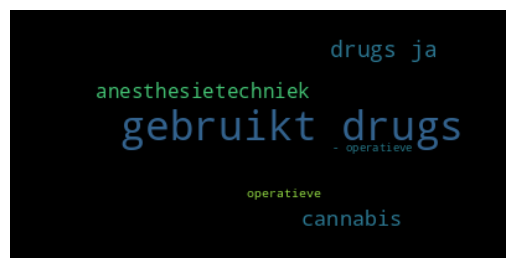

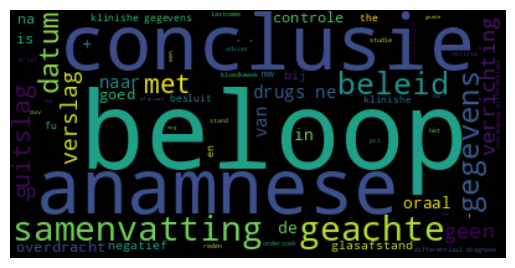

In [77]:
ex1_features = model.best_estimator_['tfidf'].get_feature_names_out()
ex1_coef = model.best_estimator_['clf'].coef_
feature_importance = pd.DataFrame(ex1_features, columns=['feature'])
ex1_coef.shape
feature_importance['eval'] = ex1_coef[0]

current_user_dictionary = {row['feature']:(row['eval'] * -1) for index, row in feature_importance.iterrows()}
wc = WordCloud().generate_from_frequencies(current_user_dictionary)
plt.imshow(wc, interpolation="bilinear")
plt.axis("off")
plt.show()

non_user_dictionary = {row['feature']:row['eval'] for index, row in feature_importance.iterrows()}
wc = WordCloud().generate_from_frequencies(non_user_dictionary)
plt.imshow(wc, interpolation="bilinear")
plt.axis("off")
plt.show()

In [27]:
_, x_test, _, y_test = train_test_split(corpus['text'], corpus['label'], test_size=0.2, random_state=50)

0.9992905405405406


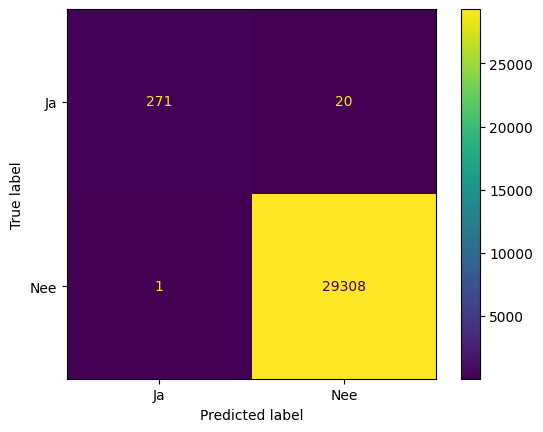

              precision    recall  f1-score   support

          Ja       1.00      0.93      0.96       291
         Nee       1.00      1.00      1.00     29309

    accuracy                           1.00     29600
   macro avg       1.00      0.97      0.98     29600
weighted avg       1.00      1.00      1.00     29600



In [28]:
predicted_nb = model.predict(x_test)
print(np.mean(predicted_nb == y_test))
cm = confusion_matrix(y_test, predicted_nb)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              display_labels=model.classes_)
disp.plot()

plt.show()
print(metrics.classification_report(y_test, predicted_nb,
    target_names=model.classes_))

In [29]:
model.classes_

array(['Ja', 'Nee'], dtype='<U3')

In [30]:
predicted_nb_df = model.decision_function(x_test)
x_test_probs = pd.DataFrame(x_test, columns=['text'])
x_test_probs['eval'] = predicted_nb_df
x_test_probs['predicted_label'] = predicted_nb
x_test_probs['true_label'] = y_test

In [31]:
pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_rows', None)

In [32]:
x_test_probs_merged = x_test_probs.merge(original_corpus['text'], left_index=True, right_index=True, suffixes = ['_processed', '_original'])

In [33]:
top100_score_yes_pred_no = x_test_probs_merged[x_test_probs_merged['predicted_label'] == 'Nee'].sort_values(by=['eval'], ascending=True)[['eval', 'text_original']].head(100)

In [34]:
top100_score_no_pred_yes = x_test_probs_merged[x_test_probs_merged['predicted_label'] == 'Ja'].sort_values(by=['eval'], ascending=False)[['eval', 'text_original']].head(100)

In [35]:
top100_score_yes_pred_no

eval  \
60878   0.014980   
22943   0.016035   
132515  0.021529   
14518   0.037491   
15383   0.039038   
117664  0.043291   
183087  0.055409   
52350   0.056540   
189063  0.064959   
198075  0.067218   
146587  0.081447   
35807   0.096002   
28180   0.103675   
235441  0.116635   
3235    0.124686   
40888   0.129287   
217244  0.141093   
36309   0.161144   
28642   0.162599   
2164    0.166755   
16970   0.169532   
30656   0.170767   
222361  0.171081   
15893   0.172282   
141966  0.183178   
40041   0.194055   
1841    0.201935   
103947  0.204711   
48344   0.212066   
87685   0.215121   
153458  0.219357   
76538   0.226658   
73235   0.230030   
124274  0.230545   
31682   0.234695   
154217  0.243525   
10079   0.251696   
7564    0.256075   
236711  0.256421   
31331   0.257435   
45565   0.258236   
86240   0.258315   
117714  0.261601   
96288   0.270552   
25099   0.289014   
27182   0.291291   
20508   0.292431   
5515    0.292431   
95929   0.314521   
185988  0.314899   
17242   0.315390   
4988    0.316428   
52268   0.318136   
125496  0.318667   
29685   0.319206   
232996  0.324020   
55540   0.326310   
234572  0.328694   
52139   0.332149   
17859   0.332193   
214509  0.332812   
30274   0.333337   
225763  0.338697   
69398   0.339163   
4424    0.341434   
161444  0.347525   
35922   0.350730   
69606   0.351360   
109390  0.355411   
28915   0.359565   
61770   0.363640   
234766  0.370245   
20392   0.372083   
98069   0.389474   
28599   0.392381   
49584   0.392566   
116717  0.393847   
27328   0.395830   
2829    0.398223   
192735  0.400723   
90952   0.401580   
720     0.402675   
223638  0.406606   
33943   0.409571   
227588  0.410422   
24277   0.410993   
70929   0.413388   
10905   0.415548   
219831  0.417737   
68767   0.419237   
31430   0.421242   
112151  0.421499   
19873   0.421893   
17657   0.426274   
93485   0.426681   
199532  0.430329   
30462   0.430960   
95963   0.432418   
166805  0.434617   
184323  0.438734   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                       

In [36]:
top100_score_no_pred_yes

eval  \
16073   0.000000   
95841  -0.000809   
72970  -0.028666   
79559  -0.045301   
80332  -0.048186   
182394 -0.081078   
61034  -0.090054   
43290  -0.095483   
161237 -0.108387   
59593  -0.112713   
207473 -0.114871   
71471  -0.138020   
188527 -0.159562   
209435 -0.181965   
132550 -0.191544   
104815 -0.204447   
175967 -0.228875   
10680  -0.234791   
156713 -0.311407   
205709 -0.324451   
80835  -0.325803   
160709 -0.348995   
78889  -0.361771   
48660  -0.385153   
72404  -0.437612   
150772 -0.471599   
19975  -0.483123   
74991  -0.488070   
8791   -0.498630   
136814 -0.519383   
206259 -0.519880   
153829 -0.534023   
182941 -0.535958   
154687 -0.538812   
135622 -0.540600   
208496 -0.550899   
109676 -0.554969   
4195   -0.558634   
169204 -0.582929   
93796  -0.595276   
189092 -0.595310   
169690 -0.595912   
128654 -0.599642   
108180 -0.610649   
155124 -0.643746   
104287 -0.649644   
20455  -0.649935   
81557  -0.663484   
92679  -0.669730   
115572 -0.672185   
100302 -0.680143   
159999 -0.687411   
116718 -0.689366   
201869 -0.693941   
215923 -0.698537   
192375 -0.701064   
8543   -0.709630   
230643 -0.749813   
202955 -0.757762   
791    -0.759094   
236675 -0.771698   
225744 -0.772202   
36243  -0.780002   
103686 -0.789125   
222461 -0.792249   
135076 -0.794650   
126801 -0.822026   
204471 -0.824060   
117233 -0.824905   
135714 -0.828125   
165775 -0.832073   
5348   -0.844209   
153296 -0.844488   
110167 -0.845320   
16329  -0.854075   
215692 -0.859106   
195548 -0.867027   
87813  -0.879289   
187627 -0.887209   
230174 -0.888272   
3551   -0.889745   
201444 -0.893824   
127049 -0.903670   
183410 -0.910503   
82919  -0.910585   
164948 -0.913986   
224453 -0.914850   
95572  -0.918168   
155613 -0.923194   
140491 -0.924499   
81873  -0.935646   
131837 -0.941692   
121476 -0.945940   
138860 -0.946886   
33814  -0.960053   
134332 -0.974880   
225069 -0.990524   
99035  -0.998336   
137373 -1.001548   
19272  -1.010257   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                       